## Build MRCNN Model -Load MRCNN and FCN weights - Load Training Files  
Pass data through MRCNN and then FCN and investigte output values from FCN
- First we generate the heatmaps, and also visually cehck them. 
- the we pass the heatmaps to the routine that prodcues the scores 


 
     train
         image_ids[:10]       :  [262145, 262146, 524291, 131074, 393221, 131075, 393223, 393224, 524297, 9]
         image_ids[1000:1010] :  [1451, 132523, 1453, 132527, 263599, 132529, 132528, 263603, 263604, 132533]
     val35k
      image_ids[:10]       :  [262148, 393225, 131089, 262161, 262162, 393243, 262175, 131108, 393254, 42]
      image_ids[1000:1010] :  [134290, 527506, 527504, 134288, 527510, 265372, 265374, 265378, 527529, 3244]

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))
%matplotlib inline
%load_ext autoreload
%autoreload 2
import sys
sys.path.append('../../')
from mrcnn.prep_notebook import (build_inference_pipeline, build_trainfcn_pipeline, prep_coco_dataset, 
                                run_training_pipeline, run_inference_pipeline)
from mrcnn.prep_notebook import get_training_batch, display_training_batch
from mrcnn.prep_notebook import get_inference_batch, get_image_batch
import numpy as np
import mrcnn.visualize as visualize
import mrcnn.utils     as utils
# from mrcnn.visualize import (plot_3d_heatmap, plot_2d_heatmap, plot_2d_heatmap_compare, plot_3d_heatmap_compare,
#                             display_heatmaps, display_heatmaps_fcn, display_heatmaps_mrcnn, display_heatmaps_mrcnn_fcn)
                             
# import matplotlib as plt
%matplotlib inline
WEIGHT_FILE = 'F:/models/train_fcn8_coco_adam/fcn20181109T0000/fcn_2298.h5'
# mrcnn_model, fcn_model = build_inference_pipeline(fcn_weight_file = WEIGHT_FILE, batch_size = 2)
mrcnn_model, fcn_model = build_trainfcn_pipeline(fcn_weight_file = WEIGHT_FILE, batch_size = 1)

dataset_train, train_generator  = prep_coco_dataset(['train','val35k'], mrcnn_model.config, generator = True)
# dataset_val, val_generator      = prep_coco_dataset(['minival'], mrcnn_config, generator = True) 
coco_class_names = dataset_train.class_names

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


Using TensorFlow backend.



--> Execution started at: 11-19-2018 @ 12:52:13
    Tensorflow Version: 1.8.0   Keras Version : 2.2.0 
--epochs 2 --steps_in_epoch 32  --last_epoch 0 --batch_size 1 --lr 0.00001 --val_steps 8 --mrcnn_logs_dir train_mrcnn_coco --fcn_logs_dir   train_fcn8_coco_adam --mrcnn_model    last --fcn_model      init --opt            adagrad --fcn_arch       fcn8 --fcn_layers     all --sysout        screen --new_log_folder    
    MRCNN Model        :  last
    FCN Model          :  init
    MRCNN Log Dir      :  train_mrcnn_coco
    FCN Log Dir        :  train_fcn8_coco_adam
    FCN Arch           :  FCN8
    FCN Log Dir        :  ['all']
    Last Epoch         :  0
    Epochs to run      :  2
    Steps in each epoch:  32
    Validation steps   :  8
    Batch Size         :  1
    Optimizer          :  ADAGRAD
    sysout             :  SCREEN
>>> Initialize Paths
 windows  Windows

Paths:
-------------------------
COCO_DATASET_PATH              F:\MLDatasets\coco2014
COCO_HEATMAP_PATH          

    >> input to MVN.PROB: pos_grid (meshgrid) shape:  (256, 256, ?, 2)
     Prob_grid shape from mvn.probe:  (256, 256, ?)
     Prob_grid shape after tanspose:  (?, 256, 256)
    << output probabilities shape  :  (?, 256, 256)
    scores_scattered shape :  (1, 81, 200, 3)
    gauss_scores  (FINAL)  :  (1, 81, 200, 11)  Keras tensor  False

    normalization ------------------------------------------------------
    normalizer     :  (?, 1, 1)
    prob_grid_norm_scaled :  (?, 256, 256)

    Scatter out the probability distributions based on class --------------
    pt2_ind shape      :  (?, 3)
    prob_grid_clippped :  (?, 256, 256)
    gauss_heatmap      :  (1, 81, 200, 256, 256)

    Reduce sum based on class ---------------------------------------------
    gaussian_heatmap :  (1, 81, 256, 256) Keras tensor  False

    normalization ------------------------------------------------------
    normalizer shape   :  (1, 81, 1, 1)
    normalized heatmap :  (1, 81, 256, 256)  Keras tensor 

   FCN Block 22 shape is               :  (None, 128, 128, 128)
   FCN Block 23 (Max pooling) shape is :  (None, 64, 64, 128)
   FCN Block 31 shape is               :  (None, 64, 64, 256)
   FCN Block 32 shape is               :  (None, 64, 64, 256)
   FCN Block 33 shape is               :  (None, 64, 64, 256)
   FCN Block 34 (Max pooling) shape is :  (?, 32, 32, 256)
   FCN Block 41 shape is               :  (None, 32, 32, 512)
   FCN Block 42 shape is               :  (None, 32, 32, 512)
   FCN Block 43 shape is               :  (None, 32, 32, 512)
   FCN Block 44 (Max pooling) shape is :  (?, 16, 16, 512)
   FCN Block 51 shape is               :  (None, 16, 16, 512)
   FCN Block 52 shape is               :  (None, 16, 16, 512)
   FCN Block 53 shape is               :  (None, 16, 16, 512)
   FCN Block 54 (Max pooling) shape is :  (None, 8, 8, 512)

   --- FCN32 ----------------------------
   FCN fully connected 1 (fc1) shape   :  (None, 8, 8, 4096)
   FCN fully connected 2 (fc2) sha

 ---> last
>>> find_last checkpoint in :  F:\models\train_mrcnn_coco
    Dir starting with  mrcnn  : ['mrcnn20181011T1100', 'mrcnn20181024T2023', 'mrcnn20181111T1438', 'mrcnn20181111T1441', 'mrcnn20181112T1039', 'mrcnn20181112T1531', 'mrcnn20181113T1636', 'mrcnn20181113T1654', 'mrcnn20181113T2154', 'mrcnn20181113T2235', 'mrcnn20181113T2259', 'mrcnn20181114T1203', 'mrcnn20181114T1204', 'mrcnn20181114T1454', 'mrcnn20181115T1017', 'mrcnn20181115T1041', 'mrcnn20181115T1114', 'mrcnn20181115T1259', 'mrcnn20181115T1503', 'mrcnn20181115T1645', 'mrcnn20181115T2042', 'mrcnn20181115T2159', 'mrcnn20181116T1221', 'mrcnn20181118T1310']
    find_last():   dir_name: F:\models\train_mrcnn_coco\mrcnn20181011T1100
    find_last(): checkpoint: F:\models\train_mrcnn_coco\mrcnn20181011T1100\mrcnn_0103.h5
>>> load_weights() from : F:\models\train_mrcnn_coco\mrcnn20181011T1100\mrcnn_0103.h5
layers type:  <class 'list'> length:  383
    Weights file loaded: F:\models\train_mrcnn_coco\mrcnn20181011T1100\mrcnn_0

####  Display next image from generator

D:\Program Files\Anaconda3\envs\TF\lib\site-packages\scipy\ndimage\interpolation.py:583: UserWarning: From scipy 0.13.0, the output shape of zoom() is calculated with round() instead of int() - for these inputs the size of the returned array has changed.
  "the returned array has changed.", UserWarning)


 Image_id    :  27547  Reference:  http://cocodataset.org/#explore?id=432615 Coco Id: 432615
 Image meta [27547   393   640     3   197     0   826  1024     1     1]
 Class ids   :  (2,)    [24 24]
 Class Names :  ['giraffe', 'giraffe']


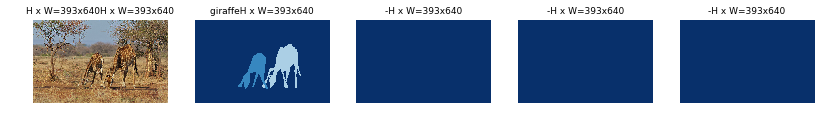

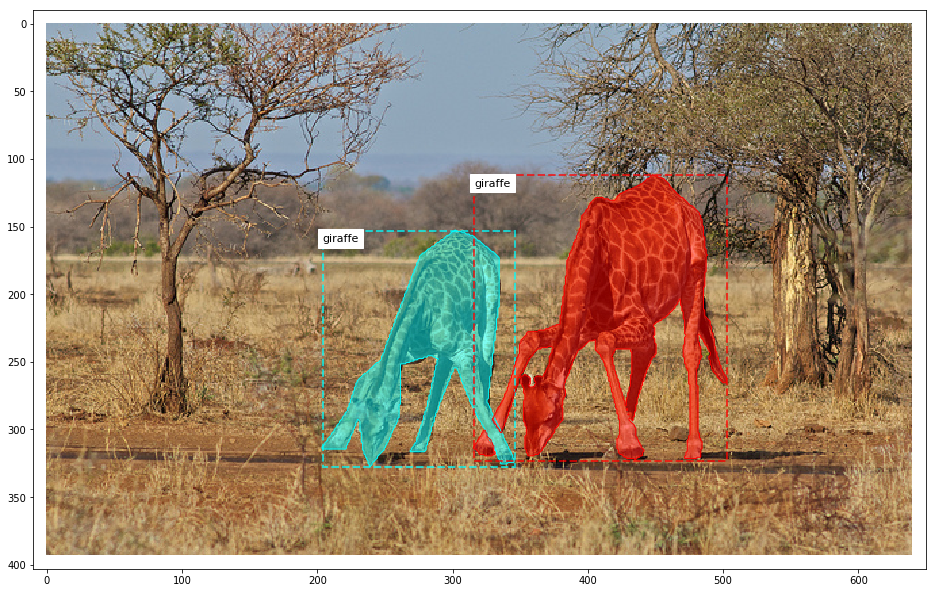

In [9]:
train_batch_x, train_batch_y = next(train_generator)
display_training_batch(dataset_train, train_batch_x, masks=True)

#### Load a specific image using image_id

 batch size is : 1
 load image ud:  0
 Image_id    :  0  Reference:  http://cocodataset.org/#explore?id=262145 Coco Id: 262145
 Image meta [   0  427  640    3  170    0  853 1024    1    1]
 Class ids   :  (32,)    [ 26  26  52  52  52  52   1   1   1   1   1   1   1   1   1   1   1   1  26  52  52  52  52  52
  52  52  52   1  26  52  -1 -52]
 Class Names :  ['umbrella', 'umbrella', 'carrot', 'carrot', 'carrot', 'carrot', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'umbrella', 'carrot', 'carrot', 'carrot', 'carrot', 'carrot', 'carrot', 'carrot', 'carrot', 'person', 'umbrella', 'carrot', 'toothbrush', 'suitcase']


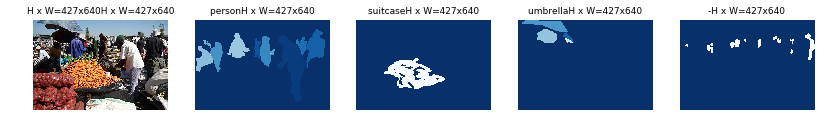

 display_instances() : Image shape:  (427, 640, 3)


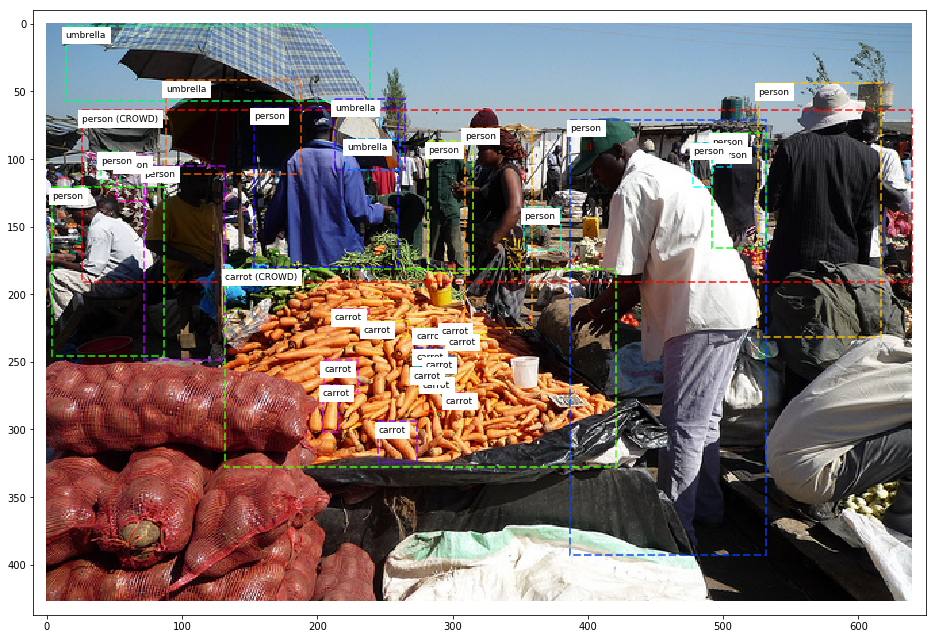

In [7]:
from mrcnn.prep_notebook import run_training_pipeline
## 62642 (persons),   68539 (trucks) 36466 (surfers)  75040 (boat and persons)
## 36466 surfers. 5498 basketbal players, 27711,30531
## 5498 lots of motorcylces & persons - 
## Persons: #26026, #7719, 111864, 58240,  
## 35347 - laptops, keyboards and cat
## items = [59199 , 102868]
## 89243: Person, bicylce and traiffic lights
## 101623 (cake and forks), 41423 (elephant & people)
## 33477 Table, bowl, cup, sandwich, knife
## 26763 Table, chair, cup , bowl, bottle
## 49316 Table, book, backpack, many bottles
## 12902 Car , truck and traffic light tree
## 57327 person and horses
## 26026 -- mountain, skiers, skiboards 
##  7719 -- people, bottles, handbags
## 27711 -- persons and boats
## 18045 -- person     
## 36769 -- people in meeting room with a 'giraffe'detection?
##  8634 -- person
## 30531 -- tennis players 
##  8645 -- two people
## 24627 -- Pizza, bowl, cups
# IMAGE_LIST = [75040] 
# IMAGE_LIST = [89243]
# IMAGE_LIST = [33477]
# IMAGE_LIST = [29731]
# IMAGE_LIST = [26763]
# IMAGE_LIST = [89243]  ## 89243: Person, bicylce and traiffic lights
# IMAGE_LIST = [43168]   ## 43168 Multiple umbrella, chairs, beds
# IMAGE_LIST = []      ## 62642 (persons),   68539 (trucks) 36466 (surfers)  75040 (boat and persons)
# IMAGE_LIST = [36466] ## 36466 surfers. 5498 basketbal players, 27711,30531
# IMAGE_LIST = [5498] lots of motorcylces & persons - 
## Persons: #26026, #7719, 111864, 58240,  
# IMAGE_LIST = [89243] ##: Person, bicycle and traiffic lights
# IMAGE_LIST = [35347] ## - people and skaeboard  
# IMAGE_LIST = [59199]  ## books , sofa, living room
# IMAGE_LIST = [102868]  ## person in an airplane
# IMAGE_LIST = [107200]   ## people, snow and skis
# IMAGE_LIST = [41423]  ## (elephant & people)
# IMAGE_LIST = [49316]  ## Table, book, backpack, many bottles
IMAGE_LIST = [0]
p = get_training_batch(dataset_train, mrcnn_model.config, IMAGE_LIST, display = True)

Loading 1 images
image                    shape: (427, 640, 3)         min:    0.00000  max:  255.00000


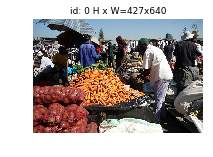

 batch size is : 1
 load image ud:  0
 Image_id    :  0  Reference:  http://cocodataset.org/#explore?id=262145 Coco Id: 262145
 Image meta [   0  427  640    3  170    0  853 1024    1    1]
 Class ids   :  (32,)    [ 26  26  52  52  52  52   1   1   1   1   1   1   1   1   1   1   1   1  26  52  52  52  52  52
  52  52  52   1  26  52  -1 -52]
 Class Names :  ['umbrella', 'umbrella', 'carrot', 'carrot', 'carrot', 'carrot', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'umbrella', 'carrot', 'carrot', 'carrot', 'carrot', 'carrot', 'carrot', 'carrot', 'carrot', 'person', 'umbrella', 'carrot', 'toothbrush', 'suitcase']


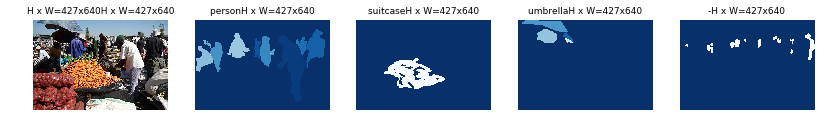

 display_instances() : Image shape:  (427, 640, 3)


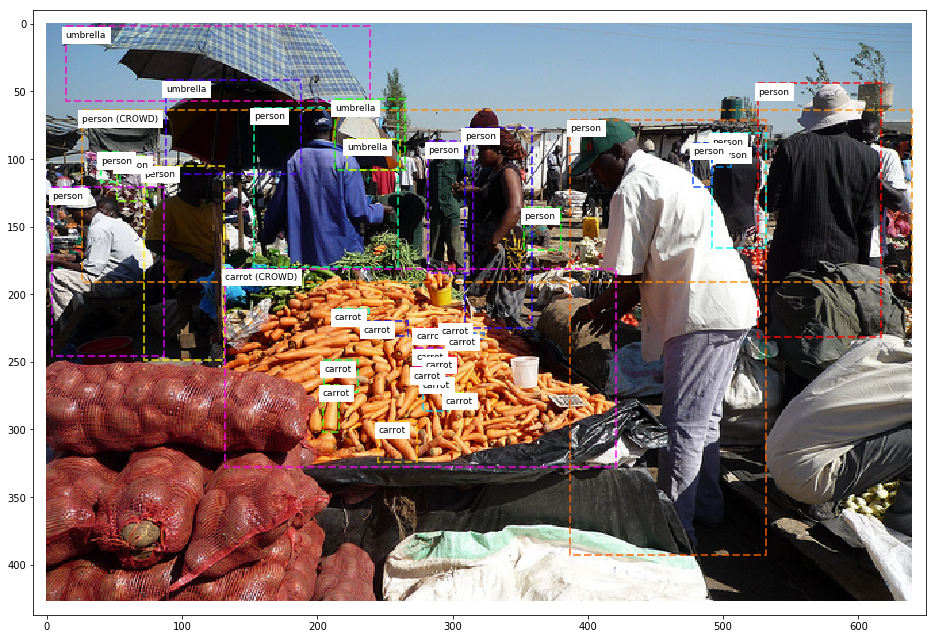

In [8]:
outputs = run_training_pipeline(mrcnn_model, fcn_model, dataset_train, IMAGE_LIST)

In [9]:
print(type(outputs), outputs.keys())
# results = mrcnn_model.detect([image], verbose=1)
# r = results[0]
print('  Length of outputs:', len(outputs))
print(outputs.keys())
for i in outputs.keys():
    print(i)
    shp = [str(j.shape) for j in outputs[i]]
    print('    ', shp)
        

<class 'dict'> dict_keys(['mrcnn_input', 'fcn_input', 'image_batch', 'mrcnn_output', 'fcn_output'])
  Length of outputs: 5
dict_keys(['mrcnn_input', 'fcn_input', 'image_batch', 'mrcnn_output', 'fcn_output'])
mrcnn_input
     ['(1, 1024, 1024, 3)', '(1, 89)', '(1, 261888, 1)', '(1, 256, 4)', '(1, 100)', '(1, 100, 4)']
fcn_input
     ['(1, 89)', '(1, 256, 256, 81)', '(1, 81, 200, 11)', '(1, 256, 256, 81)', '(1, 81, 200, 11)']
image_batch
     ['(427, 640, 3)']
mrcnn_output
     ['(1, 256, 256, 81)', '(1, 81, 200, 11)', '(1, 256, 256, 81)', '(1, 81, 200, 11)']
fcn_output
     ['(1, 256, 256, 81)', '(1, 256, 256, 81)', '(1, 1)', '(1, 1)', '(1, 81, 200, 13)']


## Pass image through MRCNN and FCN

In [11]:
# mrcnn_model.layer_info()
# from mrcnn.prep_notebook import run_pipeline, run_pipeline_on_input
# mrcnn_output, fcn_output, fcn_input = run_pipeline_on_input(mrcnn_model, fcn_model, mrcnn_input, verbose = 0)

model_pr_heatmap                = outputs['mrcnn_output'][0]          # layer:  0   shape: (1, 256, 256, 81)
model_pr_heatmap_scores         = outputs['mrcnn_output'][1]          # layer:  1   shape: (1, 81, 200, 11)
model_gt_heatmap                = outputs['mrcnn_output'][2]          # layer:  2   shape: (1, 256, 256, 81)
model_gt_heatmap_scores         = outputs['mrcnn_output'][3]          # layer:  3   shape: (1, 81, 200, 11)
model_fcn_heatmap               = outputs['fcn_output'][0]          # layer:  0   shape: (1, 256, 256, 81)
model_fcn_softmax               = outputs['fcn_output'][1]          # layer:  1   shape: ()
model_MSE_loss                  = outputs['fcn_output'][2]          # layer:  1   shape: ()
model_CE_loss                   = outputs['fcn_output'][3]          # layer:  1   shape: ()
model_fcn_scores                = outputs['fcn_output'][4]
# print('model_pr_heatmap       : ',model_gt_heatmap.shape)
# print('model_pr_heatmap_scores: ',model_gt_heatmap_scores.shape)
# print('model_gt_heatmap       : ',model_gt_heatmap.shape)
# print('model_gt_heatmap_scores: ',model_gt_heatmap_scores.shape)
# print('model_fcn_heatmap      :', model_fcn_heatmap.shape)
# print('model_fcn_softmax      :', model_fcn_softmax.shape)
# print(model_CE_loss,model_MSE_loss)
img_id = 0
print('Image id: ',img_id, ' Coco ID: ', dataset_train.image_info[img_id]['id'])
gt_class_ids = np.unique(model_gt_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
pr_class_ids = np.unique(model_pr_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
print('Image : {}  Ground Truth ClassIds: {}'.format(img_id, gt_class_ids))
print('Image : {}  Predicted    ClassIds: {}'.format(img_id, pr_class_ids))

Image id:  0  Coco ID:  262145
Image : 0  Ground Truth ClassIds: [0, 1, 26, 52]
Image : 0  Predicted    ClassIds: [0, 1, 25, 26, 27, 29, 52, 57]


## Display Heatmaps

### 2D Plots  

####  2D plot of `model_gt_heatmap` returned from model

 Image Id:  0  Display classes: [0, 1, 26, 52]
 rows   2  columns : 3 boxes.shape :  (81, 200, 11)
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


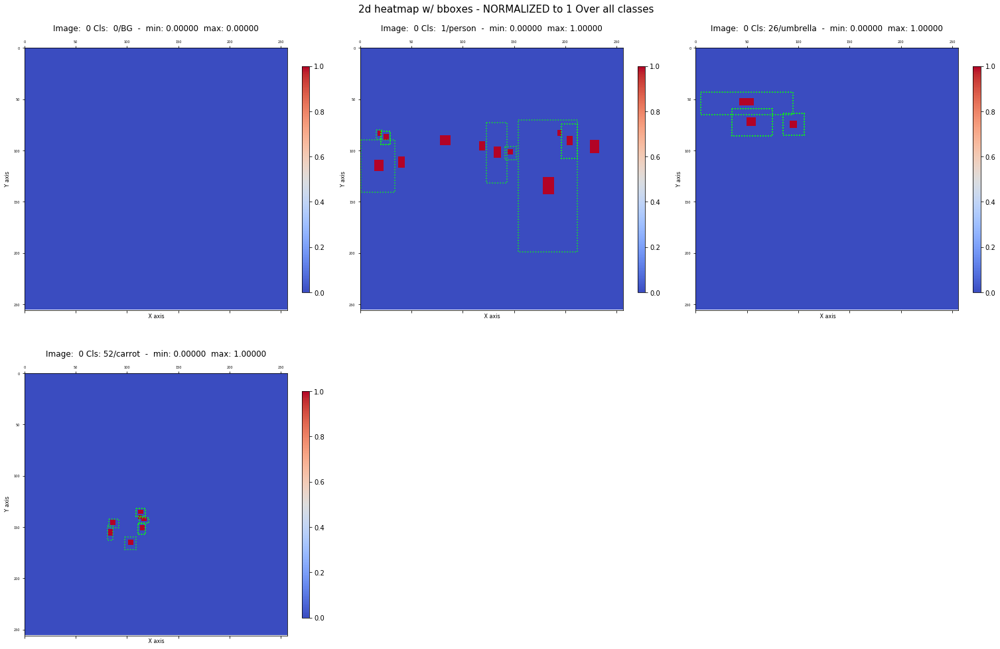

In [12]:
fig = visualize.plot_2d_heatmap(model_gt_heatmap, model_gt_heatmap_scores, img_id, gt_class_ids, 
                          class_names = coco_class_names, columns = 3, scale = 4, scaling = 'all')

####  2D plot of `pred_heatmap_norm` returned from MRCNN 

 Image Id:  0  Display classes: [0, 1, 25, 26, 27, 29, 52, 57]
 rows   3  columns : 3 boxes.shape :  (81, 200, 11)
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


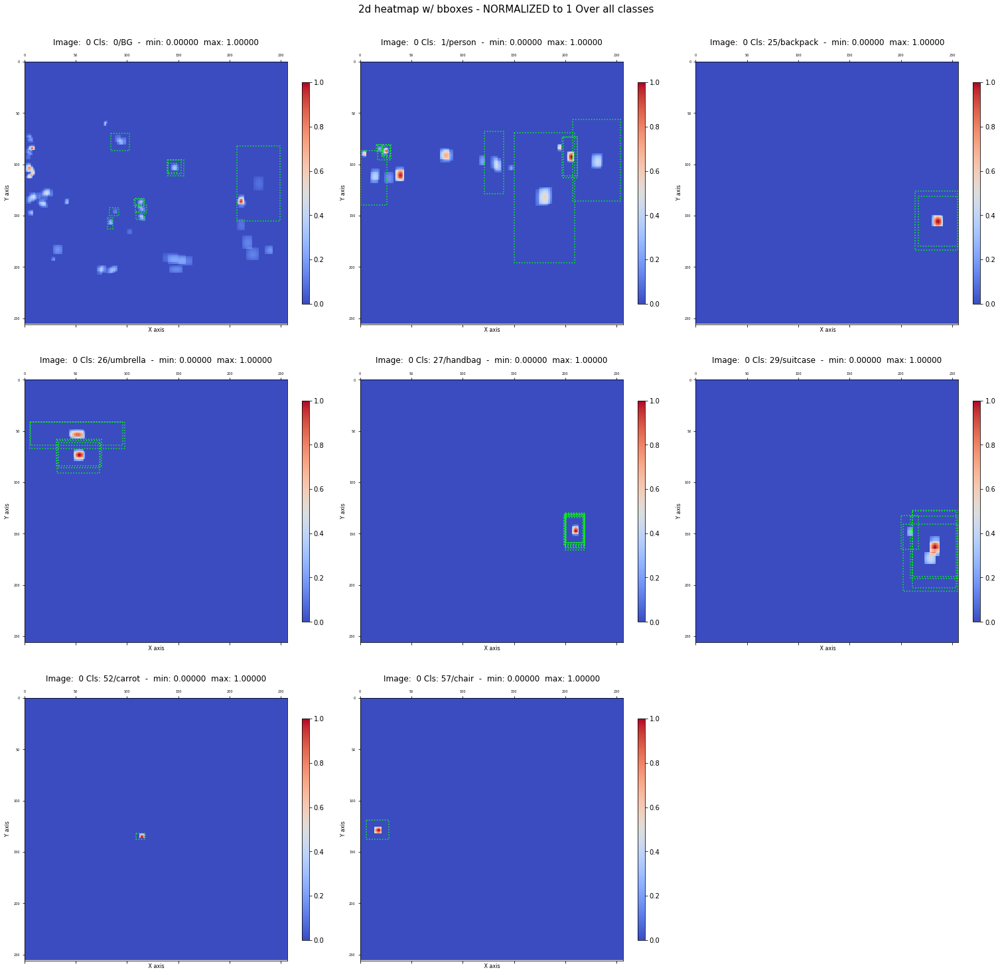

In [13]:
fig = visualize.plot_2d_heatmap(model_pr_heatmap, model_pr_heatmap_scores, img_id, pr_class_ids, columns = 3, 
                            class_names = coco_class_names, scale = 4, scaling = 'all')

####  2D plot of `model_fcn_heatmap` returned from model

 Image Id:  0  Display classes: [0, 1, 25, 26, 27, 29, 52, 57]
 rows   3  columns : 3 boxes.shape :  (81, 200, 11)
 min_z_all shape: ()  min_z_all: -0.07537415  max_z_all: () max_z_all: 1.1893774
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == class


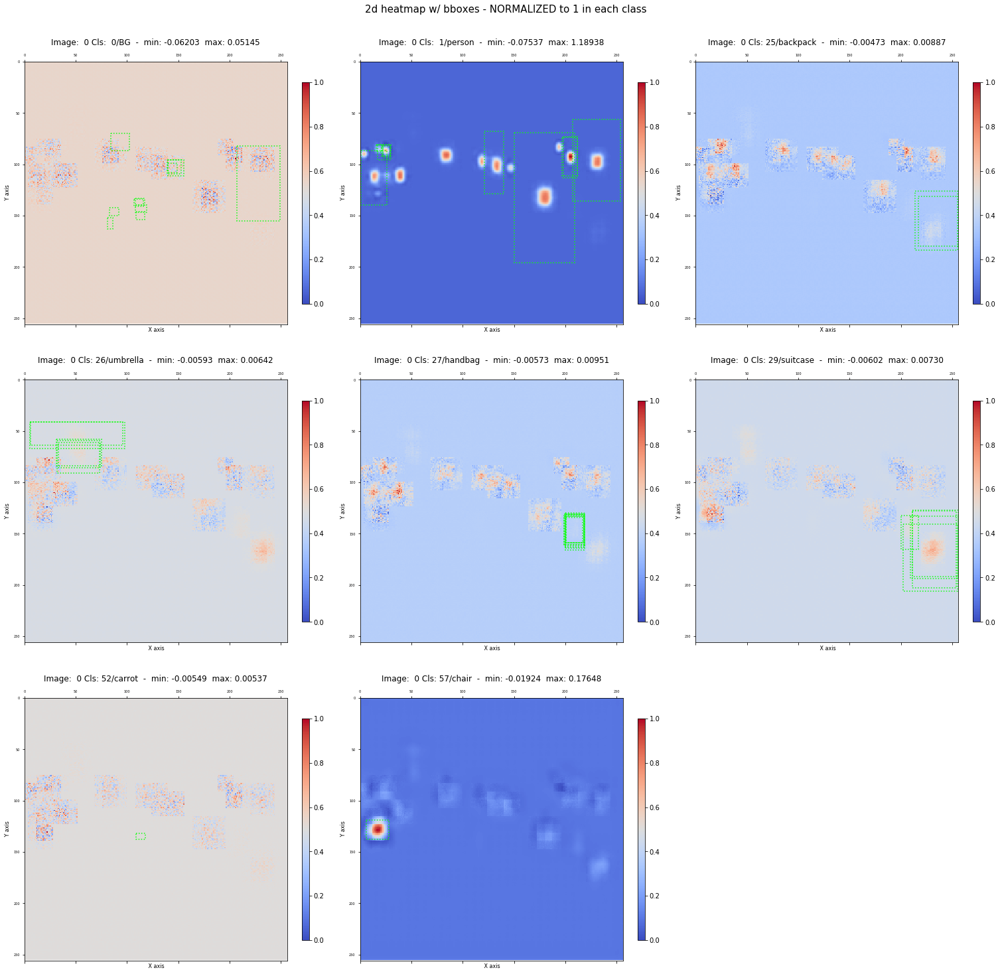

In [14]:
fig = visualize.plot_2d_heatmap(model_fcn_heatmap, model_pr_heatmap_scores, img_id, pr_class_ids, columns = 3,
                          class_names = coco_class_names, scale = 4, scaling = 'class')    # scaling: all, class, clip, none

####  2D plot of `model_fcn_heatmap` returned from model - ALL CLASSES

 Image Id:  0  Display all classes...
 rows   27  columns : 3 boxes.shape :  (81, 200, 11)
 min_z_all shape: ()  min_z_all: -0.06569519  max_z_all: () max_z_all: 1.1828173
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == class


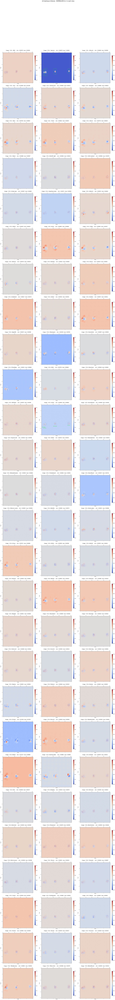

In [27]:
fig = visualize.plot_2d_heatmap(model_fcn_heatmap, model_gt_heatmap_scores, img_id,
                                class_names = coco_class_names, columns = 3, scale = 4, scaling = 'class')
# fig.savefig('fcn_heatmaps_2d.png')

####  2D comparative display `pred_heatmap` / `fcn_heatmap`  

Display classes: [0, 1, 25, 26, 27, 29, 52, 57]
 min_z1_all shape: ()  min_z1_all: 0.0  max_z1_all: () max_z1_all: 1.0
 min_z2_all shape: ()  min_z2_all: -0.07537415  max_z2_all: () max_z2_all: 1.1893774


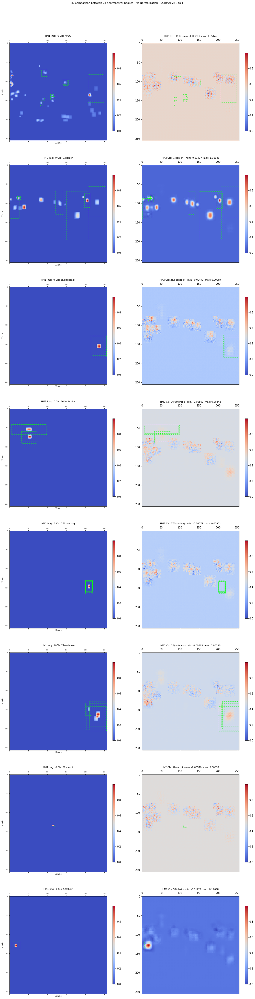

In [15]:
fig = visualize.plot_2d_heatmap_compare(model_pr_heatmap, model_fcn_heatmap, model_pr_heatmap_scores, 
                        img_id, class_ids = pr_class_ids, class_names = coco_class_names, scale = 4, scaling = 'none' )    

###  3D Plots

####  3D plot of  `gt_heatmap_norm` returned form code above

Image : 0  ClassIds: [0, 1, 2, 8, 10]
Display classes: [0, 1, 2, 8, 10]
rows   3  columns : 2
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
zlim = all   zlim_min : 0.00000000 zlim_max: 1.00000000 
 SCALING == class


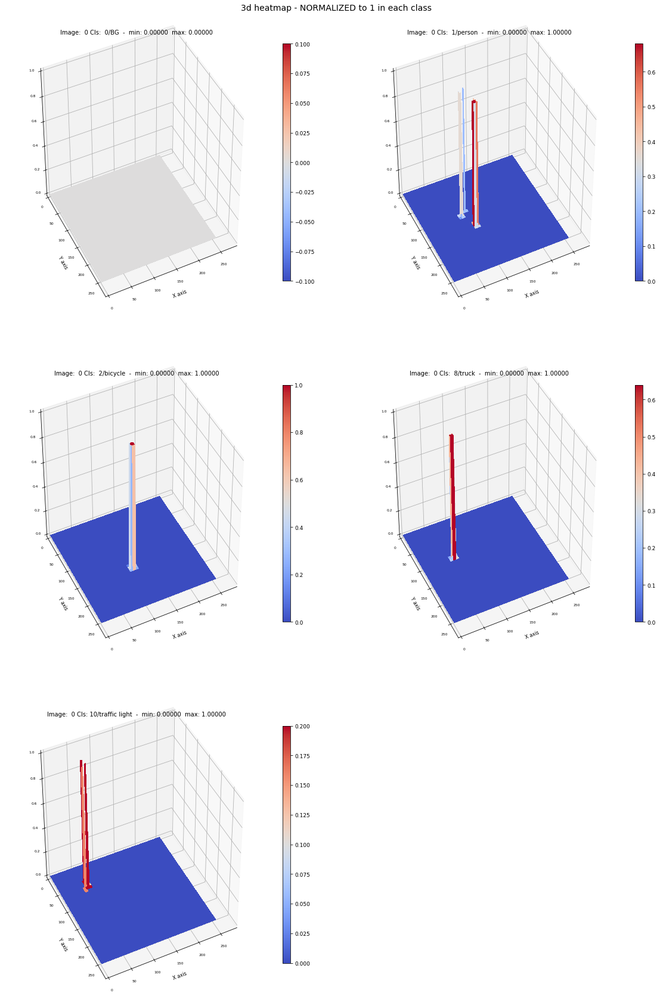

In [34]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
visualize.plot_3d_heatmap(model_gt_heatmap, img_id, gt_class_ids, class_names = coco_class_names, scaling='class')

####  3D plot of `pred_heatmap_norm` returned form model

Image : 0  ClassIds: [0, 1, 2, 3, 10]
Display classes: [0, 1, 2, 3, 10]
rows   3  columns : 2
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 


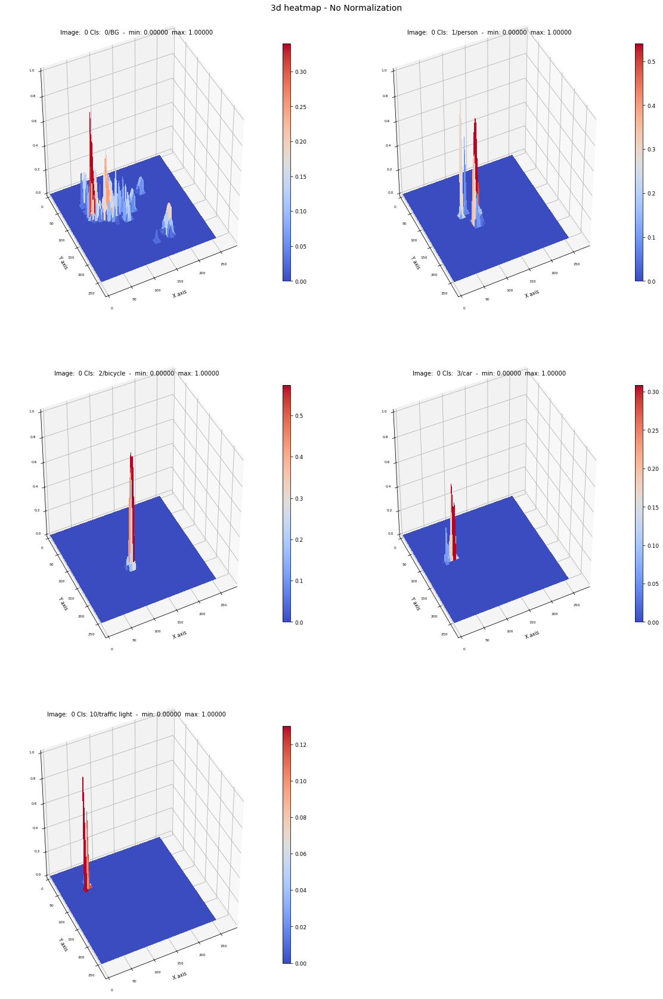

In [38]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap(model_pr_heatmap, img_id, pr_class_ids, class_names = coco_class_names, zlim = 'class' , scaling = 'none')

####  3D plot of `fcn_heatmap` returned form model - only classes in pred_scores

1.0054814 -0.07213605
Image : 0  ClassIds: [0, 1, 2, 3, 10]
Display classes: [0, 1, 2, 3, 10]
rows   3  columns : 2
 min_z_all shape: ()  min_z_all: -0.07213605  max_z_all: () max_z_all: 1.0054814
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 
1 zlim = each  zlim_min : -0.04918735 zlim_max: 0.04423909 
1 zlim = each  zlim_min : -0.07213605 zlim_max: 1.00548136 
1 zlim = each  zlim_min : -0.00786482 zlim_max: 0.01213216 
1 zlim = each  zlim_min : -0.00898363 zlim_max: 0.02093699 
1 zlim = each  zlim_min : -0.00705333 zlim_max: 0.00658484 


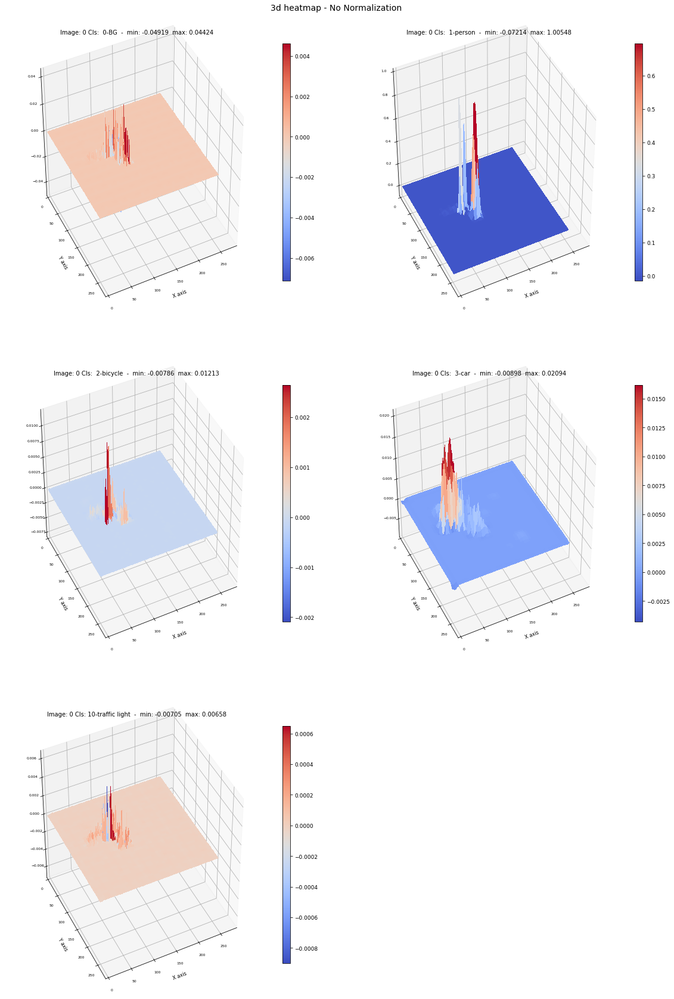

In [44]:
print(np.max(model_fcn_heatmap), np.min(model_fcn_heatmap))

print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap(model_fcn_heatmap, img_id, pr_class_ids,class_names = coco_class_names, scaling = 'none')

####  3D plot of `fcn_heatmap` returned form model - all classes

Image : 0  ClassIds: [0, 1, 2, 3, 10]
Display all classes...
rows   21  columns : 4
 min_z_all shape: ()  min_z_all: -0.07213605  max_z_all: () max_z_all: 1.0054814
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all
zlim = all   zlim_min : -0.07213605 zlim_max: 1.00548136 


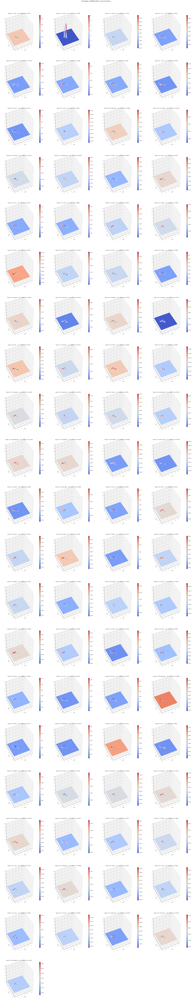

In [45]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
#     plot_3d_heatmap(model_fcn_heatmap, img_id, class_ids,class_names = class_names, size = (8,8), zlim=0)
visualize.plot_3d_heatmap(model_fcn_heatmap, img_id, class_names = coco_class_names, columns = 3,scaling = 'all')

####  3D comparative display `pred_heatmap` / `fcn_heatmap` 

In [ ]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap_compare(model_pr_heatmap, model_fcn_heatmap, img_id, class_ids = pr_class_ids, 
                            class_names = coco_class_names, size=(8,8), zlim = 'all' , scaling = 'all')

####  3D comparative display `gt_heatmap` / `fcn_heatmap` 

Image : 0  ClassIds: [0, 1, 2, 8, 10]
Display classes: [0, 1, 2, 8, 10]
 image height/width  256 256
shape pos  (256, 256, 2) shape Z1:  (256, 256, 81) shape Z2: (256, 256, 81)
 min_z1_all shape: ()  min_z1_all: 0.0  max_z1_all: () max_z1_all: 1.0
 min_z2_all shape: ()  min_z2_all: -0.07213605  max_z2_all: () max_z2_all: 1.0054814
 min_z_all shape: ()  min_z_all: -0.07213605  max_z_all: () max_z_all: 1.0054814
 min_z1_cls shape: (1, 1, 81)  max_z1_cls shape: (1, 1, 81)
 min_z2_cls shape: (1, 1, 81)  max_z2_cls shape: (1, 1, 81)
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
ttl:  HM1 Img:  0 Cls:  0/BG  -  min: 0.00000  max: 0.00000
ttl:  HM2 Img:  0 Cls:  0/BG  -  min: -0.04919  max: 0.04424
ttl:  HM1 Img:  0 Cls:  1/person  -  min: 0.00000  max: 1.00000
ttl:  HM2 Img:  0 Cls:  1/person  -  min: -0.07214  max: 1.00548
ttl:  HM1 Img:  0 Cls:  2/bicycle  -  min: 0.00000  max: 1.00000
ttl:  HM2 Img:  0 Cls:  2/bicycle  -  min: -0.00786  max: 0.01213
ttl:  HM1 Img:  0 Cls:  8/t

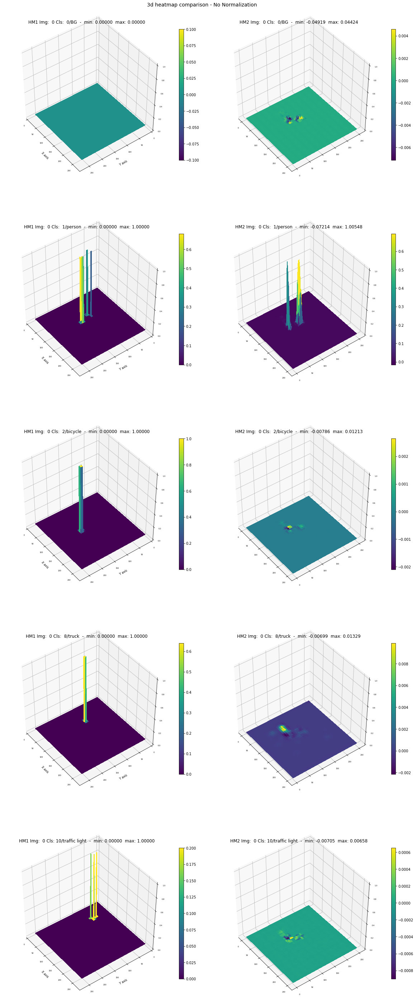

In [73]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
visualize.plot_3d_heatmap_compare(model_gt_heatmap, model_fcn_heatmap, img_id, gt_class_ids, class_names = coco_class_names, scaling = 'none')

### Overlay predictions on image

#### Overlay image with gt_heatmaps

Image shape : (1024, 1024, 3)  class_ids: [ 0  1 31]
 heatmap shape:  (256, 256, 81) boxes shape:  (81, 200, 4)


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


 scales shape:  (4,)   shifts shape:  (4,)
 scales:  [0.625 0.625 0.625 0.625] shifts:  [128   0 128   0]
clip_to_window_np()
     boxes.shape:  (81, 200, 4)
     window     :  [0, 0, 480, 640]


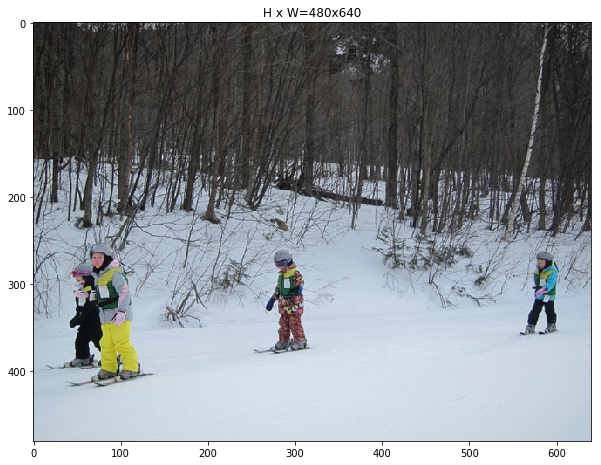

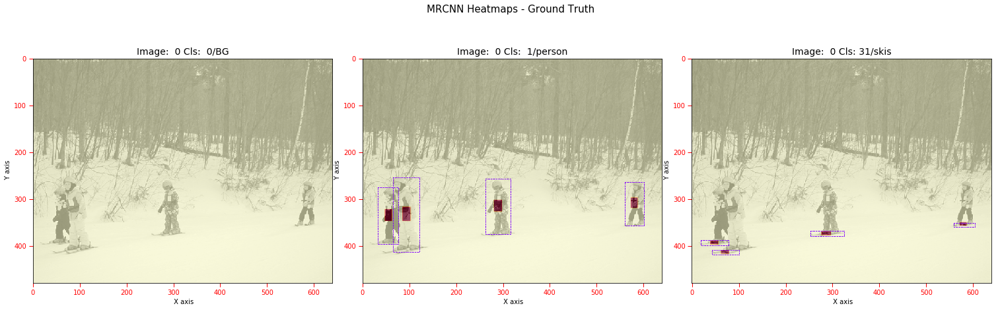

In [34]:
visualize.display_heatmaps_mrcnn(outputs['mrcnn_input'], outputs['mrcnn_output'], 0, hm = 'gt', columns = 3, 
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names)

#### Overlay image with pred_heatmaps

Image shape : (1024, 1024, 3)  class_ids: [ 0  1 25 26 27 29 52 57]
 heatmap shape:  (256, 256, 81) boxes shape:  (81, 200, 4)


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


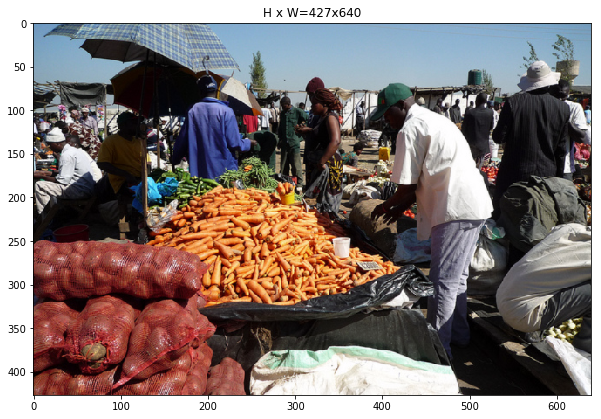

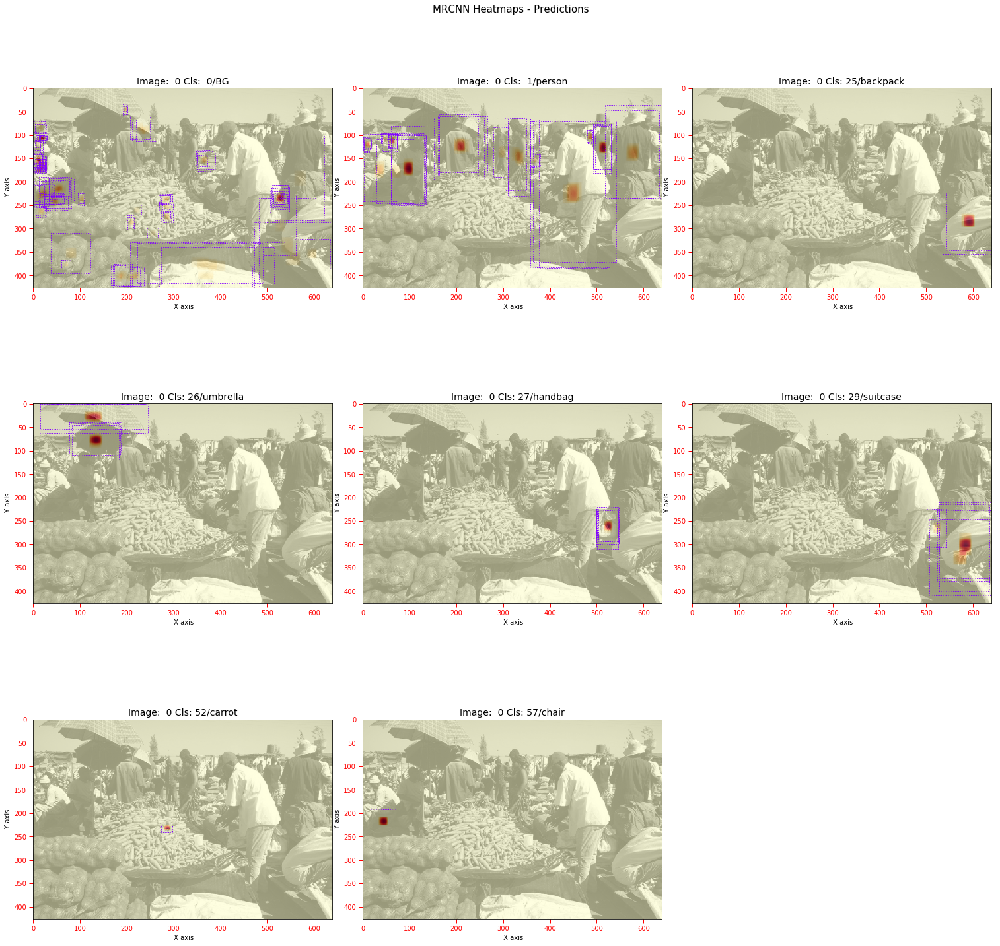

In [23]:
visualize.display_heatmaps_mrcnn(outputs['mrcnn_input'], outputs['mrcnn_output'], 0, hm = 'pr', columns = 3,
                     config = mrcnn_model.config, class_ids = pr_class_ids, class_names = coco_class_names)

#### Overlay image with fcn_heatmaps

 Bounding boxes shape:  (81, 200, 11)
Image shape : (1024, 1024, 3)  class_ids: [0, 1, 26, 52]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


 min_z_all:  () -0.07537415  max_z_all : () 1.1893774
 SCALING == none (clip to [-1, +1])
 Title:  Cls:  0/BG - min: -0.06203  max: 0.05145  avg: -0.00005
 Title:  Cls:  1/person - min: -0.07537  max: 1.18938  avg: 0.01394
 Title:  Cls: 26/umbrella - min: -0.00593  max: 0.00642  avg: -0.00001
 Title:  Cls: 52/carrot - min: -0.00549  max: 0.00537  avg: -0.00000


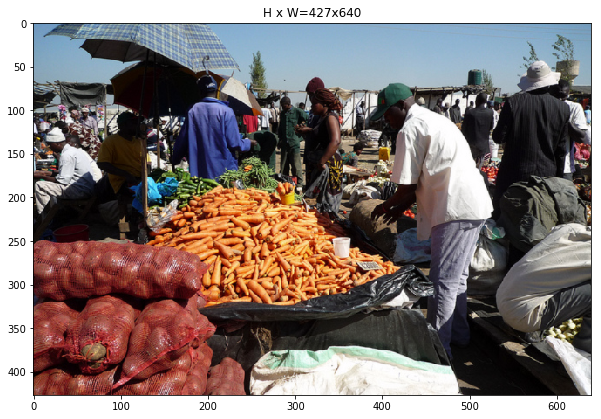

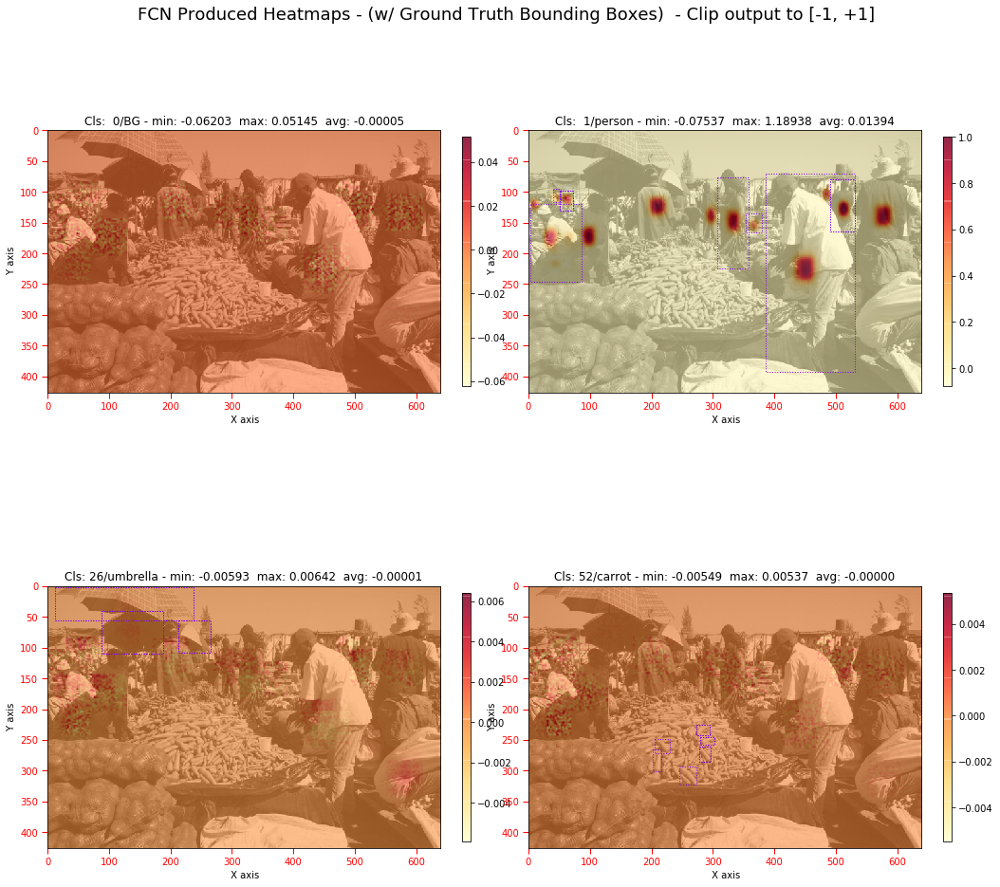

In [26]:
visualize.display_heatmaps_mrcnn_fcn(outputs['mrcnn_input'], outputs['mrcnn_output'], 0, heatmap = model_fcn_heatmap, hm = 'gt', columns = 2,
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'clip')

#### Overlay image with gt_heatmaps and fcn_heatmaps

 Bounding boxes shape:  (81, 200, 11)
Image shape : (1024, 1024, 3)  class_ids: [0, 1, 26, 52]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


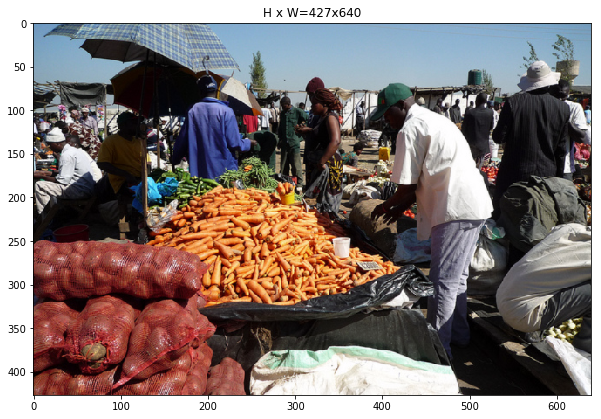

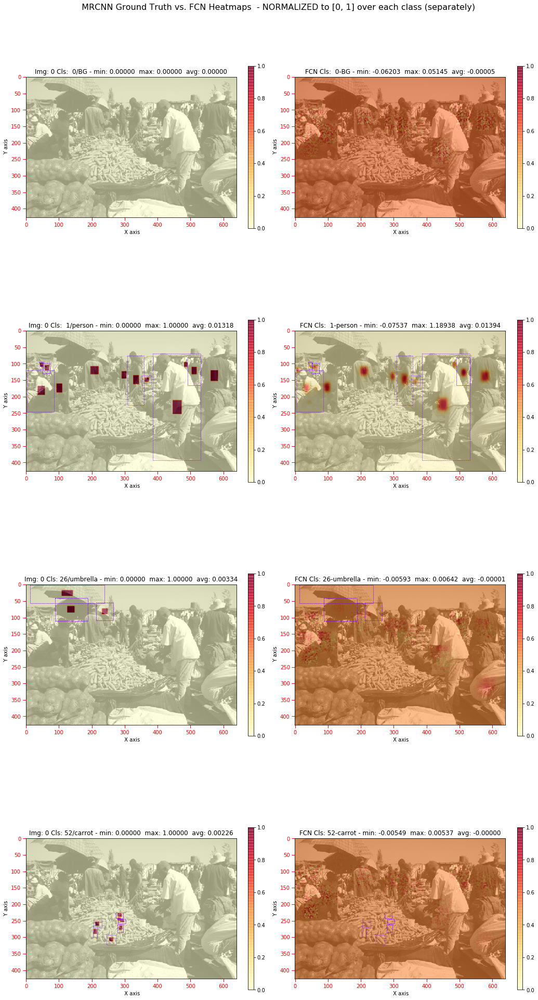

In [17]:
visualize.display_heatmaps_compare(outputs['mrcnn_input'], outputs['mrcnn_output'], heatmap = model_fcn_heatmap, image_id = 0, 
                                   hm = 'gt', config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'each')

#### Overlay image with pr_heatmaps and fcn_heatmaps

 Bounding boxes shape:  (81, 200, 11)
Image shape : (1024, 1024, 3)  class_ids: [0, 1, 26, 52]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


 SCALING == clip (clip to [-1, +1])


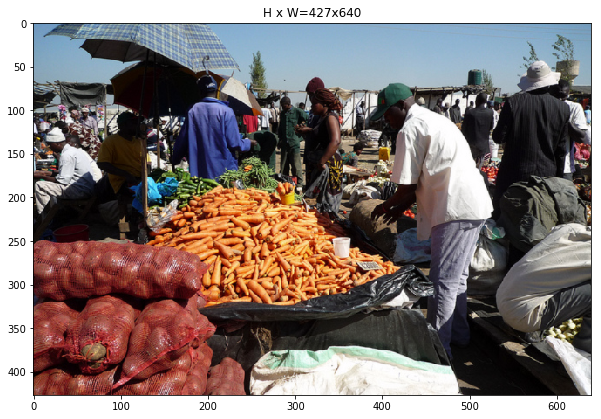

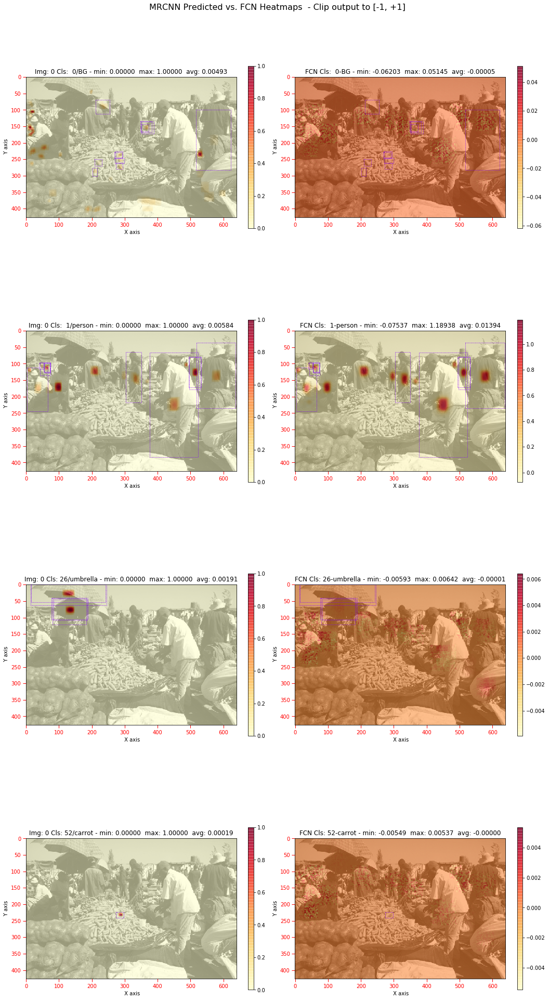

In [18]:
visualize.display_heatmaps_compare(outputs['mrcnn_input'], outputs['mrcnn_output'],
                     heatmap = model_fcn_heatmap, image_id = 0, hm = 'pr', 
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'clip')

In [31]:
# outputs.keys()
print(outputs['fcn_output'][4])

[[[[537.0865 430.2159 567.0042 ...   0.6696   0.0007   0.5993]
   [587.6985 438.3518 617.6884 ...   0.8777   0.0016   0.603 ]
   [568.7202 334.9168 603.4391 ...   0.6687   0.0008   0.5997]
   ...
   [  0.       0.       0.     ...   0.       0.       0.    ]
   [  0.       0.       0.     ...   0.       0.       0.    ]
   [  0.       0.       0.     ...   0.       0.       0.    ]]

  [[295.3533 794.8462 455.4244 ...   0.9829  39.6706   0.3103]
   [325.3958  64.9276 355.9525 ...   0.5065   4.6986   0.0368]
   [349.4764   4.9999 562.6445 ...   0.9857  47.996    0.3755]
   ...
   [  0.       0.       0.     ...   0.       0.       0.    ]
   [  0.       0.       0.     ...   0.       0.       0.    ]
   [  0.       0.       0.     ...   0.       0.       0.    ]]

  [[  0.       0.       0.     ...   0.       0.       0.    ]
   [  0.       0.       0.     ...   0.       0.       0.    ]
   [  0.       0.       0.     ...   0.       0.       0.    ]
   ...
   [  0.       0.       0.    